## Simulate tropospheric turbulence based on Yunjun et al. (2020, AGU)

+ Yunjun, Z., Fattahi, H., Agram, P., Rosen, P., & Simons, M. (2020). InSAR uncertainty due to phase unwrapping errors. Paper presented at the _AGU Fall Meeting Abstracts_, G023-08.

In [1]:
%matplotlib inline
import os
import sys
import numpy as np
from matplotlib import pyplot as plt
from mintpy.objects import timeseries
from mintpy.utils import readfile, writefile, utils as ut
from mintpy.cli import view
from unwrap_error.simulation import turbulence as turbu

work_dir = os.path.expanduser('~/Papers/2024-Yang-Tropo/notebooks/tropo_turbu')
os.chdir(work_dir)
print('Go to directory:', work_dir)

data_dir = os.path.expanduser('~/Papers/2024-Yang-Tropo/data/mintpy')
low_freq, freq0, high_freq = 1/2e3, 1/5e2, 1/2e2
kwargs = dict(freq0=freq0, low_freq=low_freq, high_freq=high_freq)

Go to directory: /Users/yunjunz/Papers/2024-Yang-Tropo/notebooks/tropo_turbu


In [2]:
ts_res_file = os.path.join(data_dir, 'timeseriesResidual_ramp.h5')
mask_file = os.path.join(data_dir, 'maskTempCoh.h5')

# read basic info
ts_obj = timeseries(ts_res_file)
ts_obj.open()
reso = np.rint(abs(float(ts_obj.metadata['Y_STEP']) * 108e3))
date_list = ts_obj.dateList
num_date = len(date_list)

open timeseries file: timeseriesResidual_ramp.h5


### Estimate PSD parameters

1/28 20150209


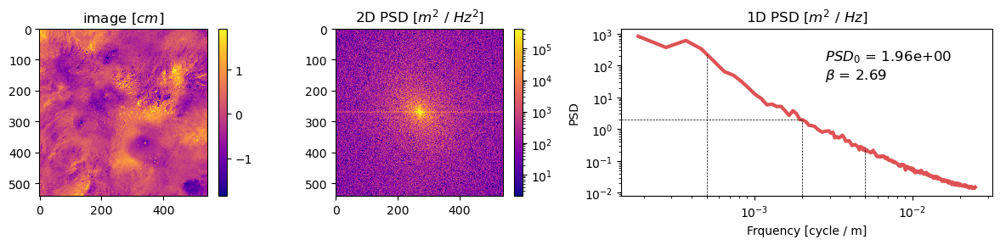

2/28 20150223


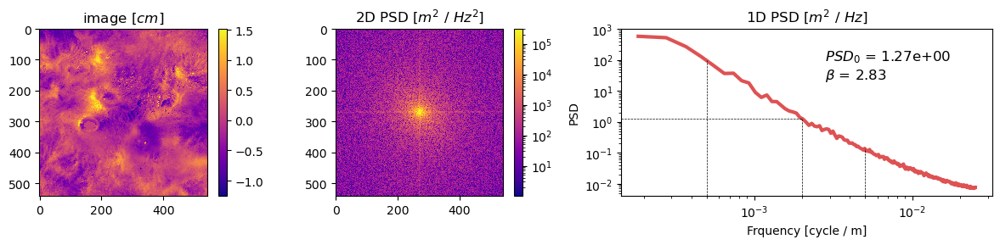

3/28 20150810


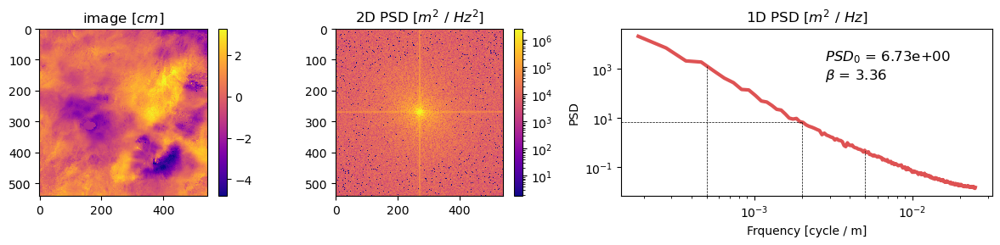

4/28 20150824


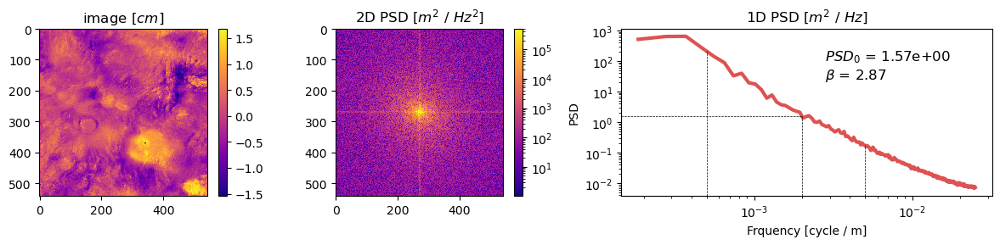

5/28 20150907


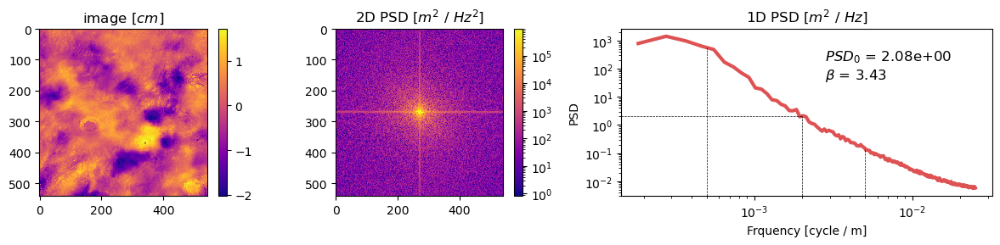

6/28 20150921


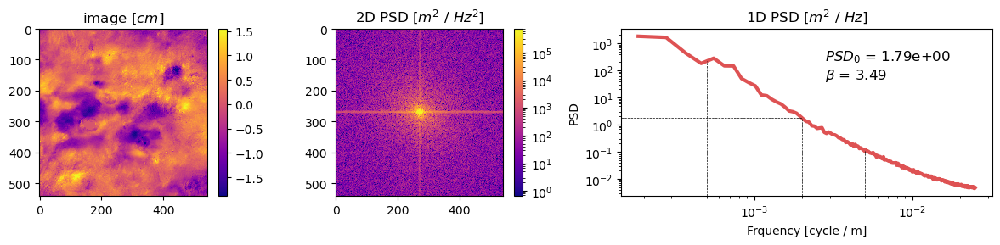

7/28 20151130


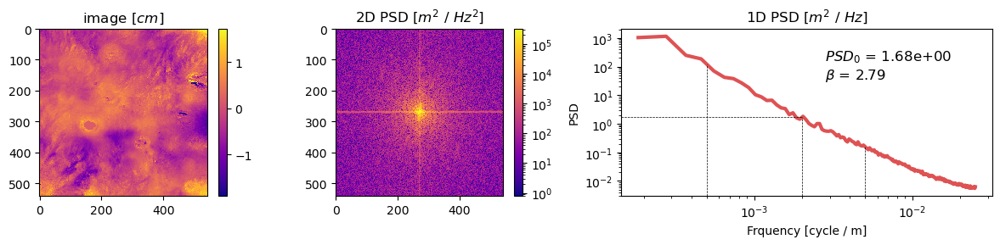

8/28 20160307


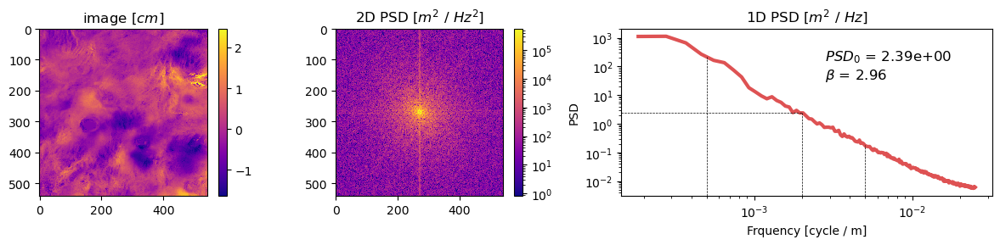

9/28 20160418


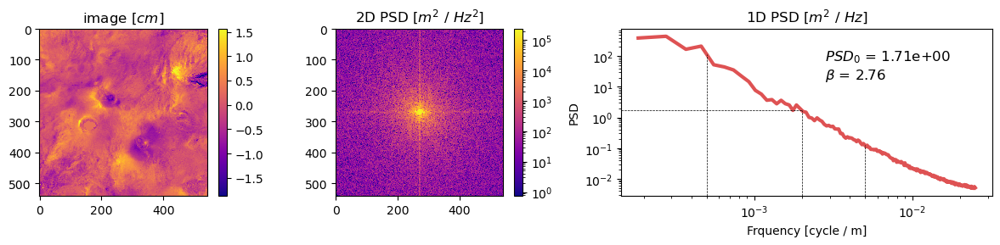

10/28 20160502


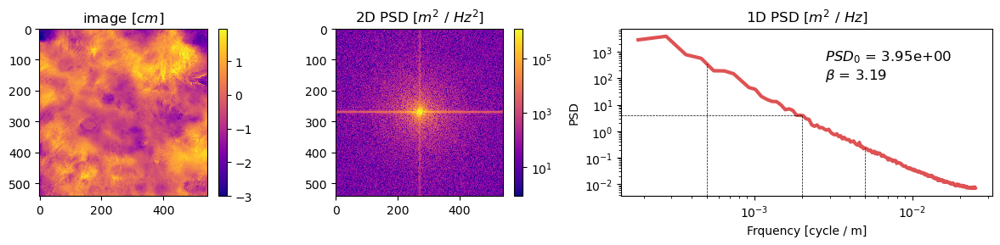

11/28 20160516


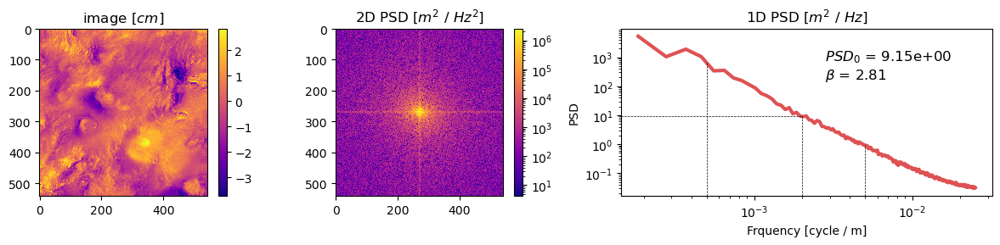

12/28 20160613


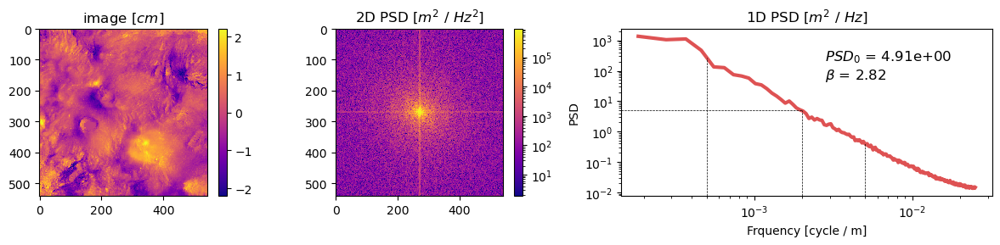

13/28 20160627


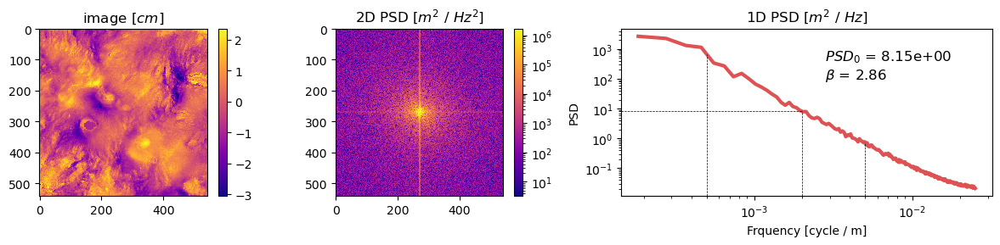

14/28 20160711


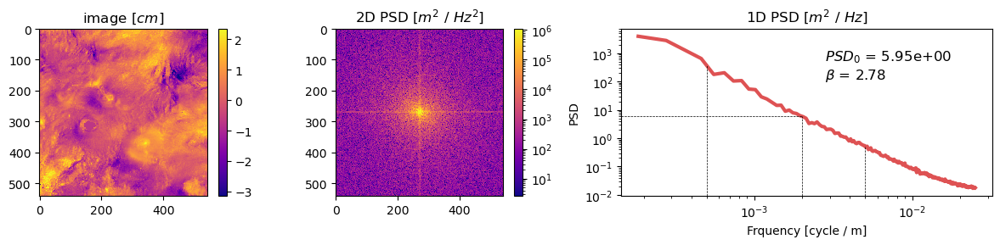

15/28 20160725


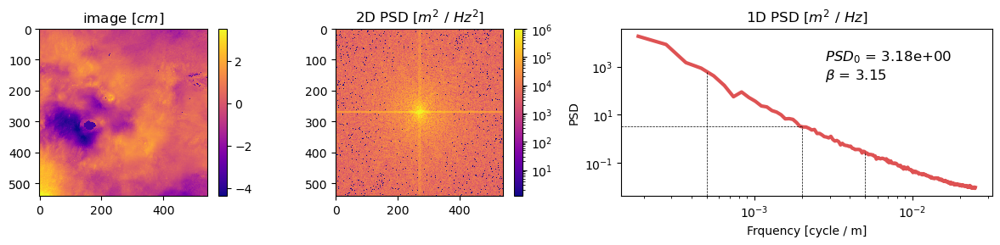

16/28 20160808


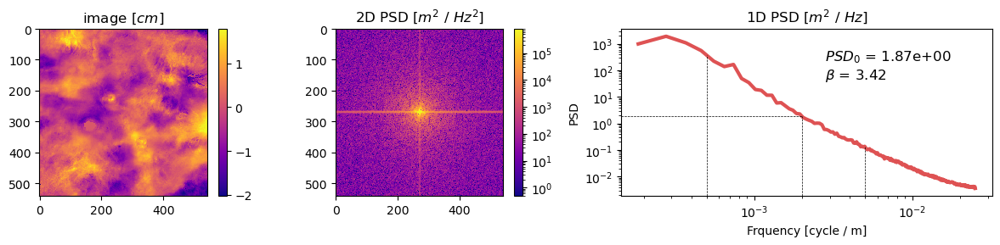

17/28 20160905


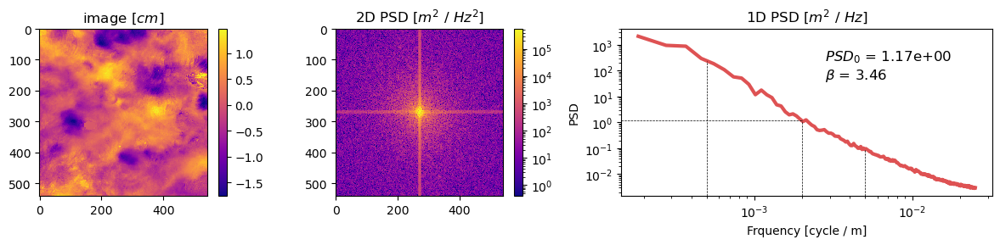

18/28 20160919


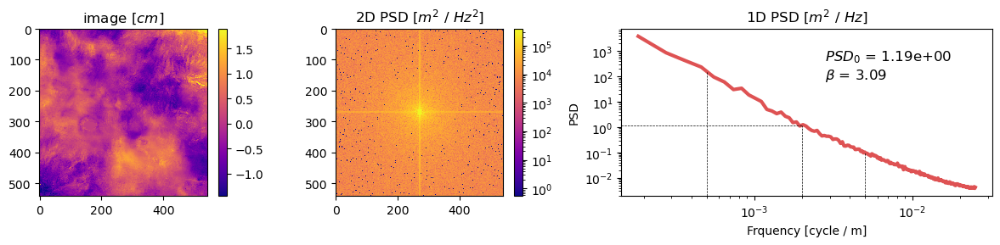

19/28 20161003


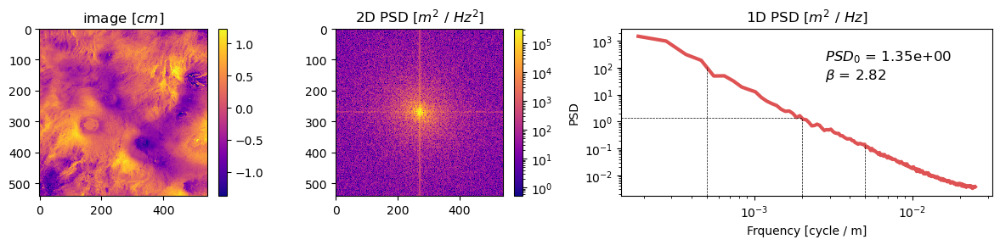

20/28 20161017


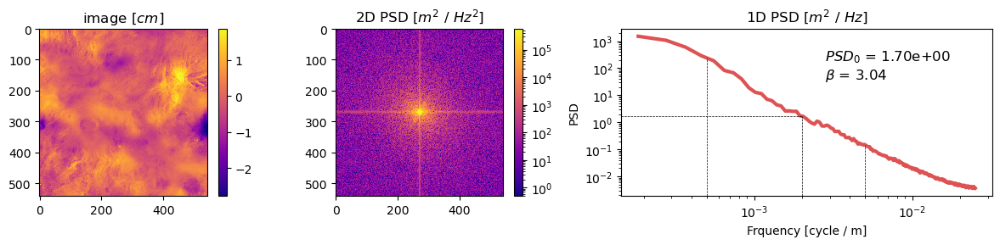

21/28 20161031


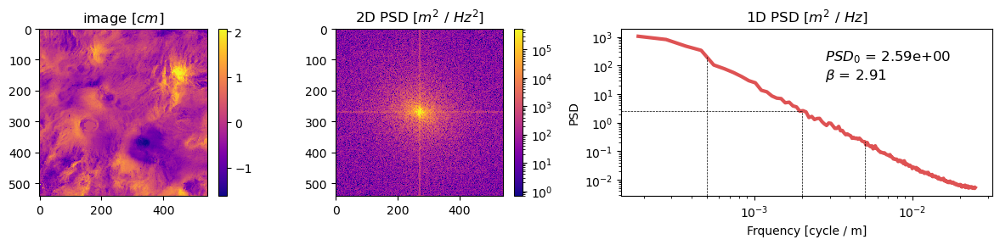

22/28 20161114


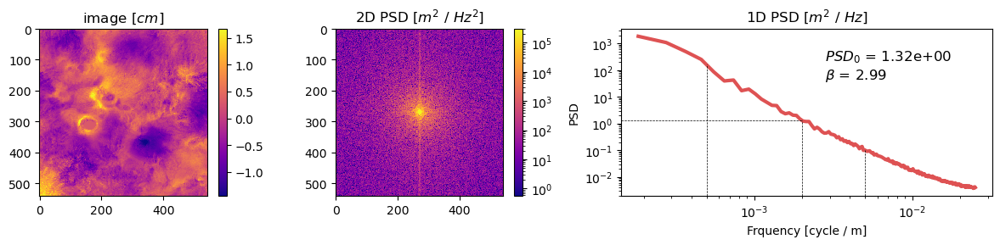

23/28 20170306


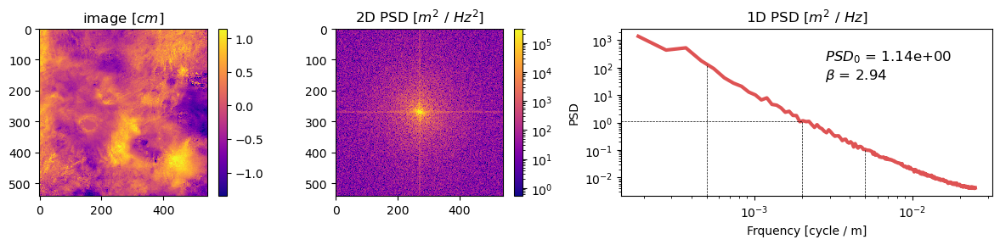

24/28 20170501


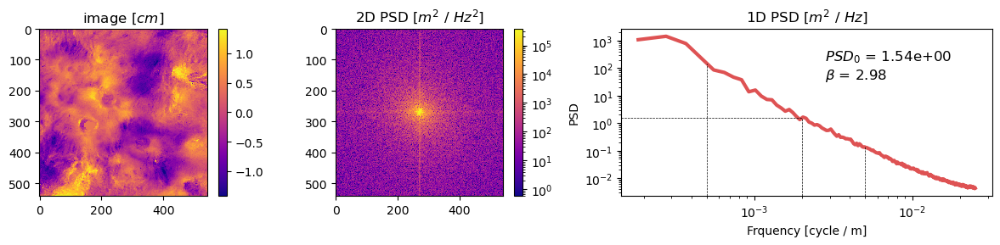

25/28 20170515


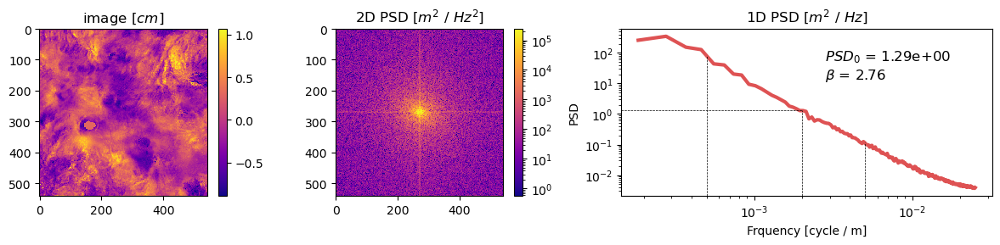

26/28 20170612


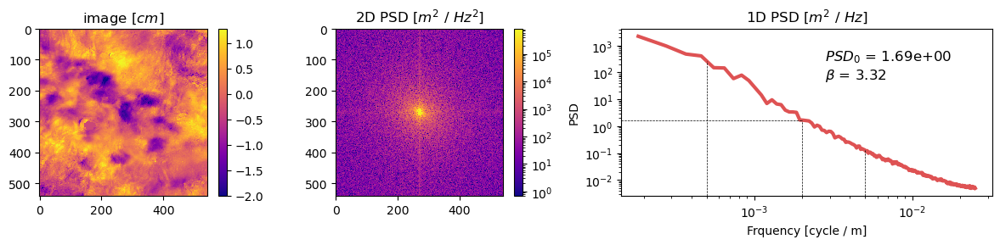

27/28 20170821


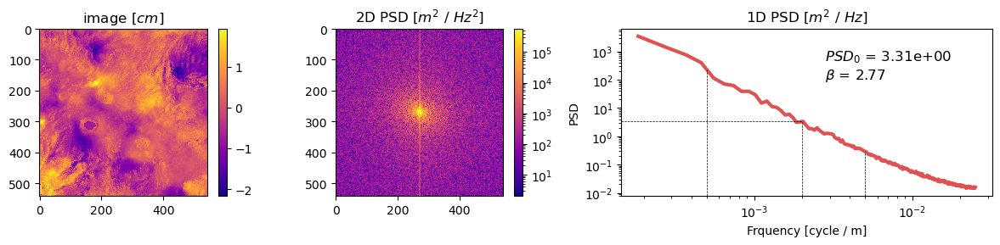

28/28 20170918


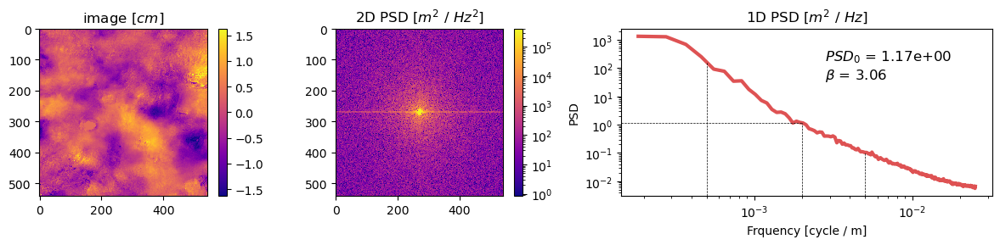

Done.


In [3]:
p0, beta = np.zeros(num_date, dtype=np.float32), np.zeros(num_date, dtype=np.float32)
p0_list, beta_list = [], []
for i, date_str in enumerate(date_list):
    print(f'{i+1}/{num_date} {date_str}')
    res_data = readfile.read(ts_res_file, datasetName=date_str)[0]
    p0[i], beta[i] = turbu.get_power_spectral_density(res_data, pixel_size=reso, display=True, **kwargs)[:2]
print('Done.')

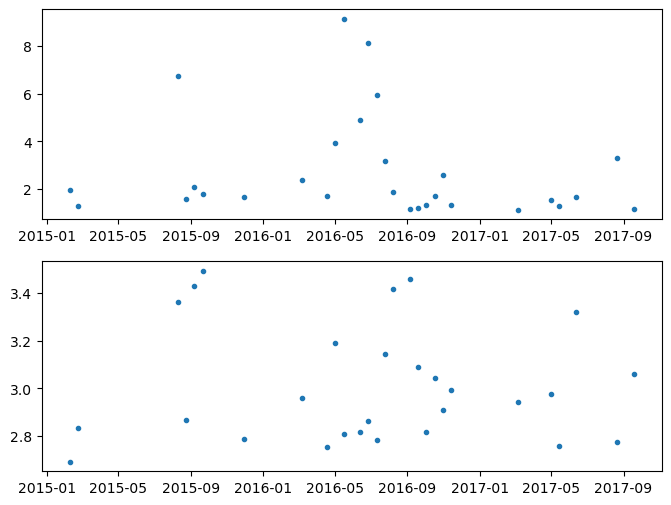

In [4]:
fig, axs = plt.subplots(nrows=2, ncols=1, figsize=[8, 6])
axs[0].plot(ts_obj.times, p0, '.')
axs[1].plot(ts_obj.times, beta, '.')
plt.show()

### Estimate tropospheric turbulence

1/28 20170918


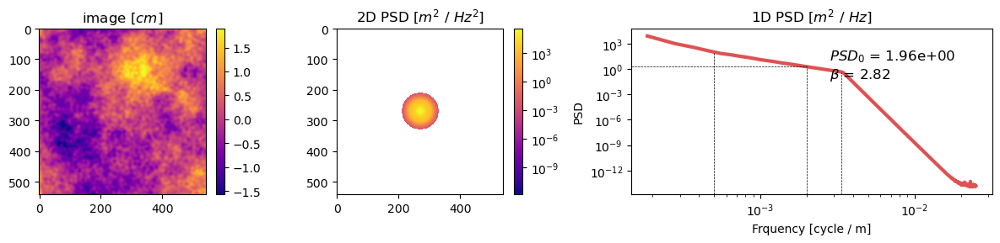

Specified p0 / beta: 2.0 m^2/Hz, 2.7
Simulated p0 / beta: 2.0 m^2/Hz, 2.8
2/28 20170918


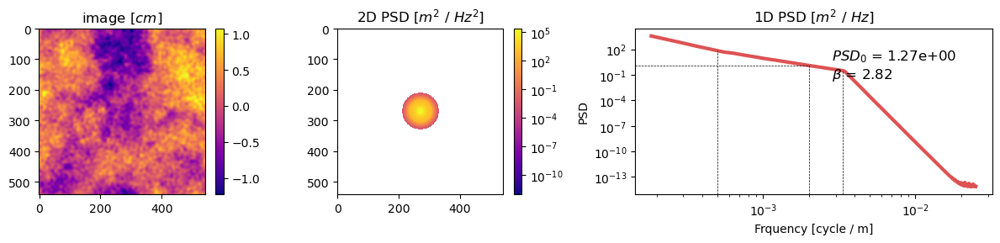

Specified p0 / beta: 1.3 m^2/Hz, 2.8
Simulated p0 / beta: 1.3 m^2/Hz, 2.8
3/28 20170918


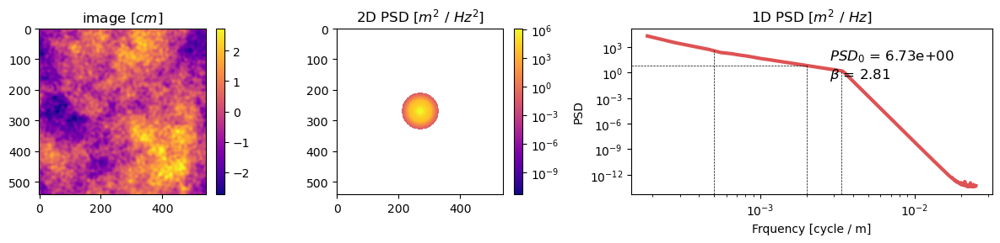

Specified p0 / beta: 6.7 m^2/Hz, 3.4
Simulated p0 / beta: 6.7 m^2/Hz, 2.8
4/28 20170918


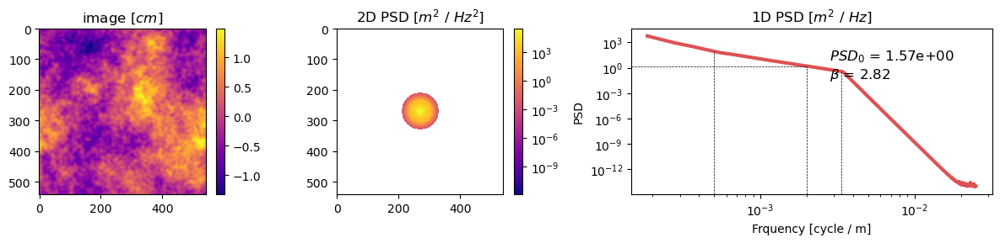

Specified p0 / beta: 1.6 m^2/Hz, 2.9
Simulated p0 / beta: 1.6 m^2/Hz, 2.8
5/28 20170918


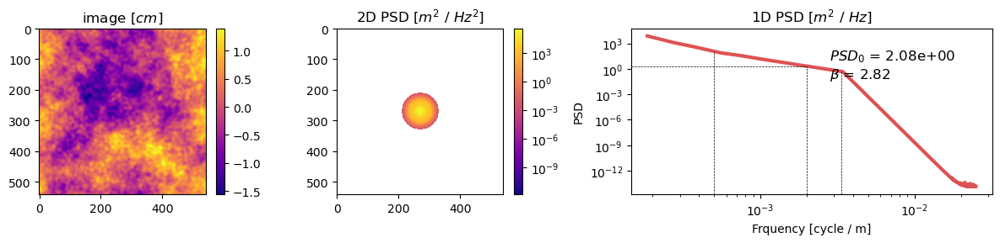

Specified p0 / beta: 2.1 m^2/Hz, 3.4
Simulated p0 / beta: 2.1 m^2/Hz, 2.8
6/28 20170918


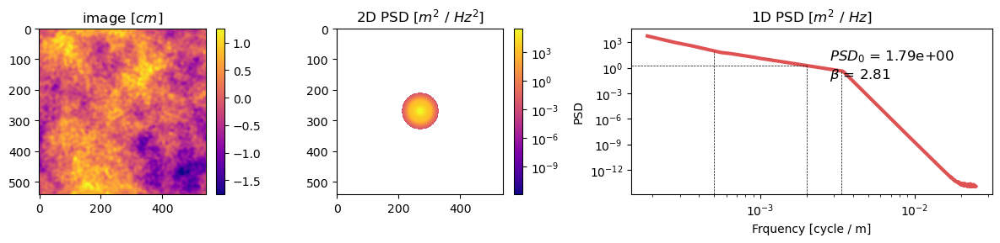

Specified p0 / beta: 1.8 m^2/Hz, 3.5
Simulated p0 / beta: 1.8 m^2/Hz, 2.8
7/28 20170918


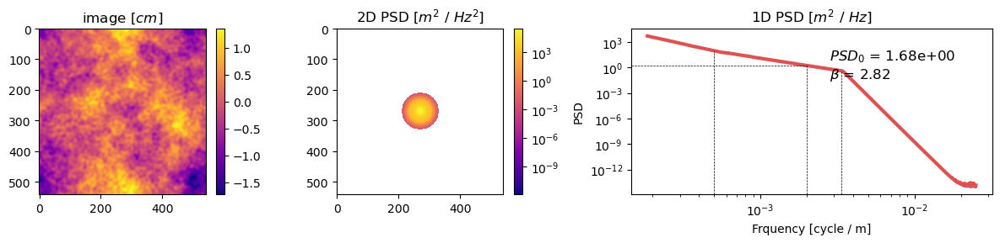

Specified p0 / beta: 1.7 m^2/Hz, 2.8
Simulated p0 / beta: 1.7 m^2/Hz, 2.8
8/28 20170918


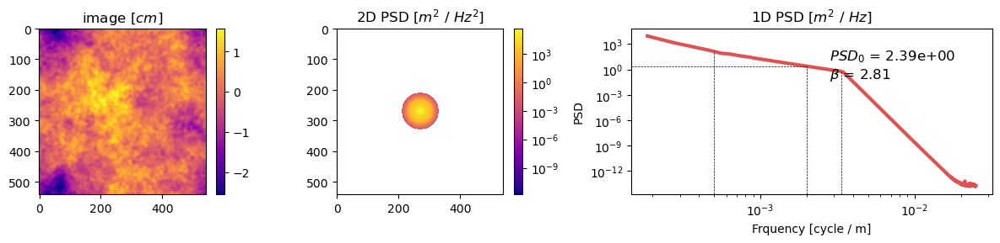

Specified p0 / beta: 2.4 m^2/Hz, 3.0
Simulated p0 / beta: 2.4 m^2/Hz, 2.8
9/28 20170918


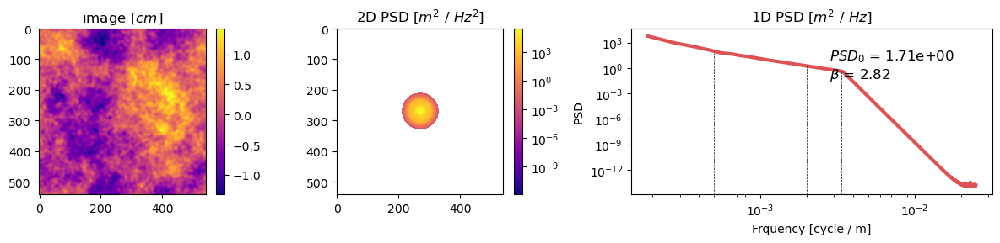

Specified p0 / beta: 1.7 m^2/Hz, 2.8
Simulated p0 / beta: 1.7 m^2/Hz, 2.8
10/28 20170918


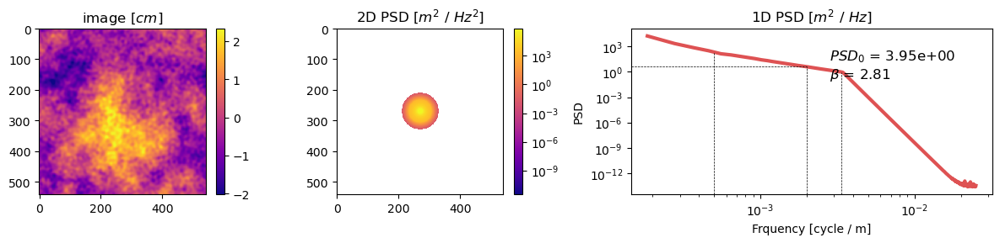

Specified p0 / beta: 3.9 m^2/Hz, 3.2
Simulated p0 / beta: 3.9 m^2/Hz, 2.8
11/28 20170918


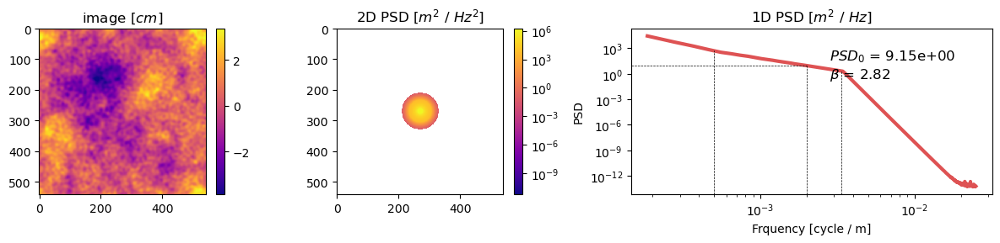

Specified p0 / beta: 9.1 m^2/Hz, 2.8
Simulated p0 / beta: 9.1 m^2/Hz, 2.8
12/28 20170918


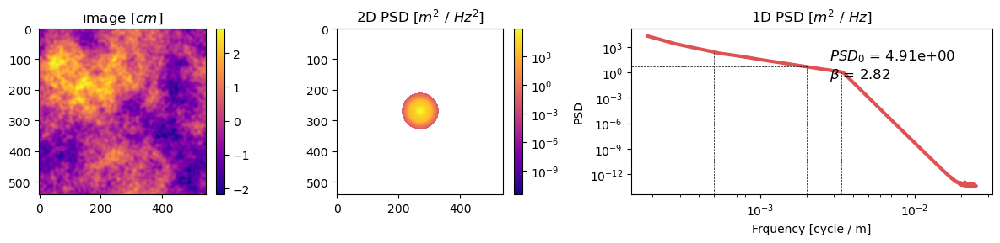

Specified p0 / beta: 4.9 m^2/Hz, 2.8
Simulated p0 / beta: 4.9 m^2/Hz, 2.8
13/28 20170918


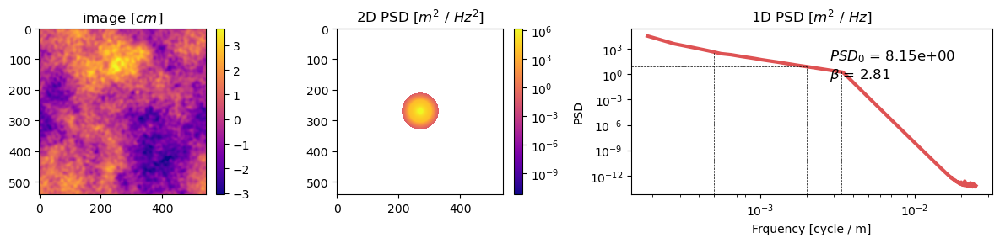

Specified p0 / beta: 8.1 m^2/Hz, 2.9
Simulated p0 / beta: 8.1 m^2/Hz, 2.8
14/28 20170918


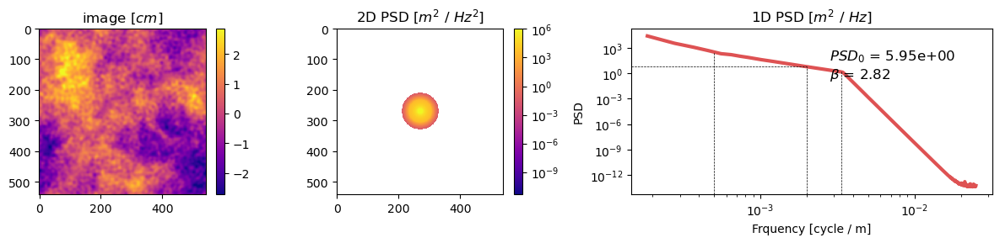

Specified p0 / beta: 6.0 m^2/Hz, 2.8
Simulated p0 / beta: 6.0 m^2/Hz, 2.8
15/28 20170918


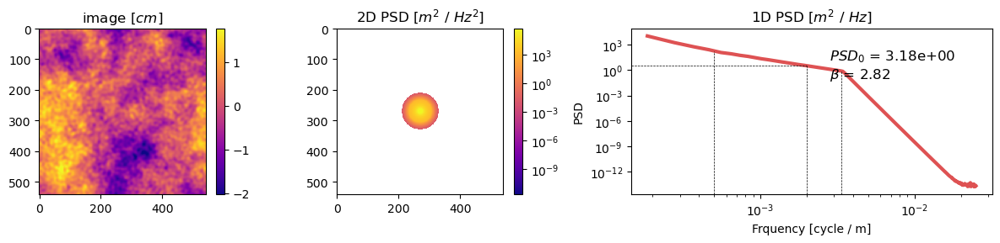

Specified p0 / beta: 3.2 m^2/Hz, 3.1
Simulated p0 / beta: 3.2 m^2/Hz, 2.8
16/28 20170918


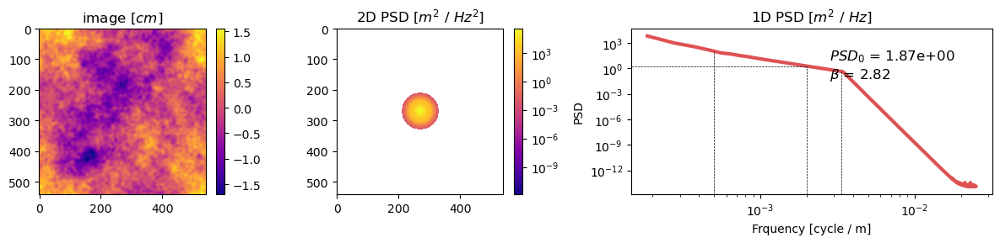

Specified p0 / beta: 1.9 m^2/Hz, 3.4
Simulated p0 / beta: 1.9 m^2/Hz, 2.8
17/28 20170918


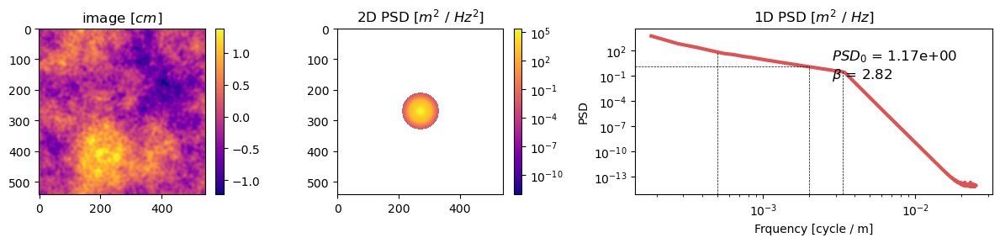

Specified p0 / beta: 1.2 m^2/Hz, 3.5
Simulated p0 / beta: 1.2 m^2/Hz, 2.8
18/28 20170918


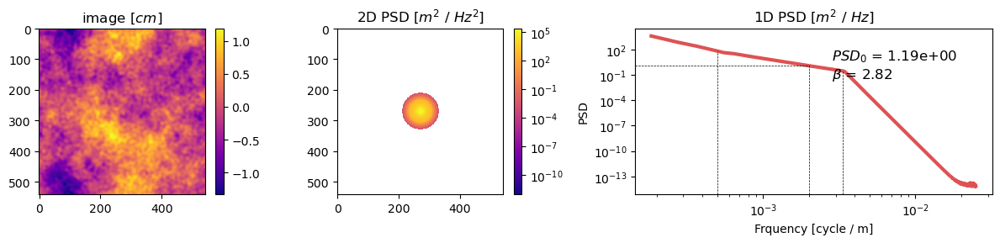

Specified p0 / beta: 1.2 m^2/Hz, 3.1
Simulated p0 / beta: 1.2 m^2/Hz, 2.8
19/28 20170918


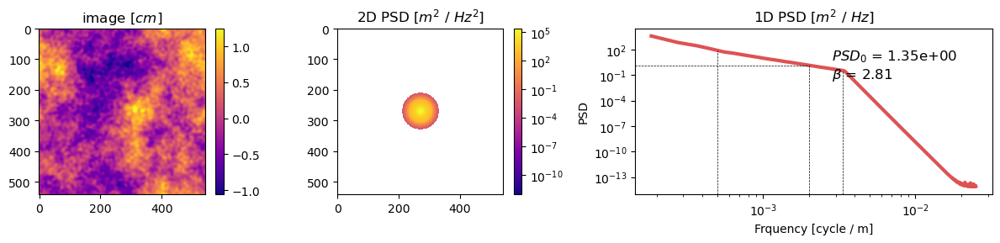

Specified p0 / beta: 1.4 m^2/Hz, 2.8
Simulated p0 / beta: 1.4 m^2/Hz, 2.8
20/28 20170918


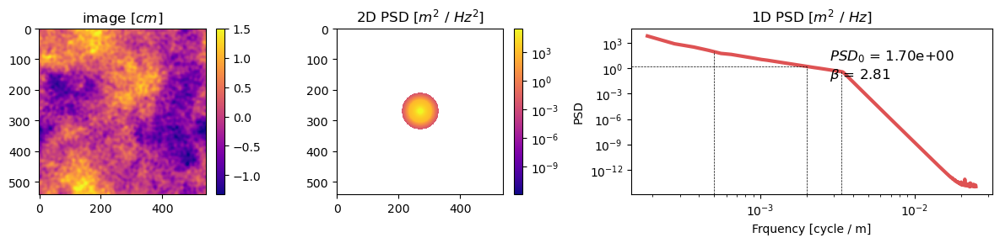

Specified p0 / beta: 1.7 m^2/Hz, 3.0
Simulated p0 / beta: 1.7 m^2/Hz, 2.8
21/28 20170918


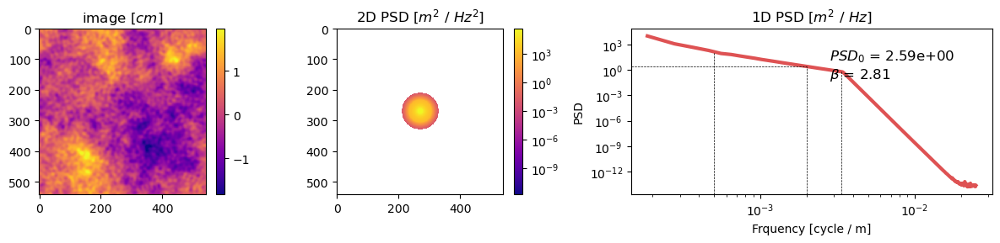

Specified p0 / beta: 2.6 m^2/Hz, 2.9
Simulated p0 / beta: 2.6 m^2/Hz, 2.8
22/28 20170918


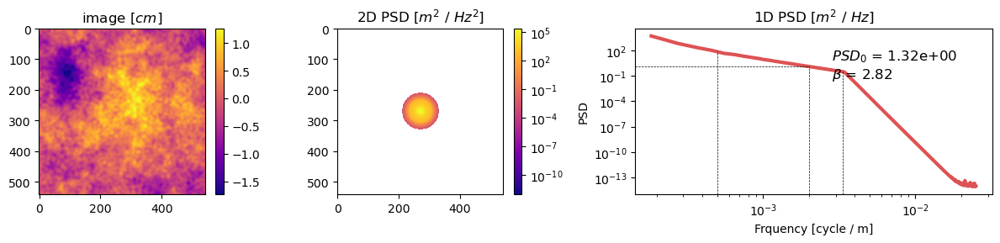

Specified p0 / beta: 1.3 m^2/Hz, 3.0
Simulated p0 / beta: 1.3 m^2/Hz, 2.8
23/28 20170918


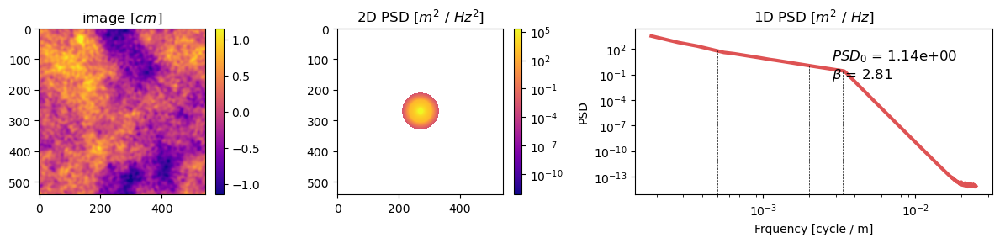

Specified p0 / beta: 1.1 m^2/Hz, 2.9
Simulated p0 / beta: 1.1 m^2/Hz, 2.8
24/28 20170918


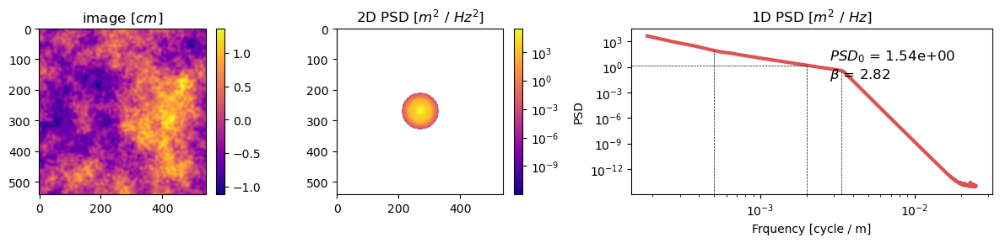

Specified p0 / beta: 1.5 m^2/Hz, 3.0
Simulated p0 / beta: 1.5 m^2/Hz, 2.8
25/28 20170918


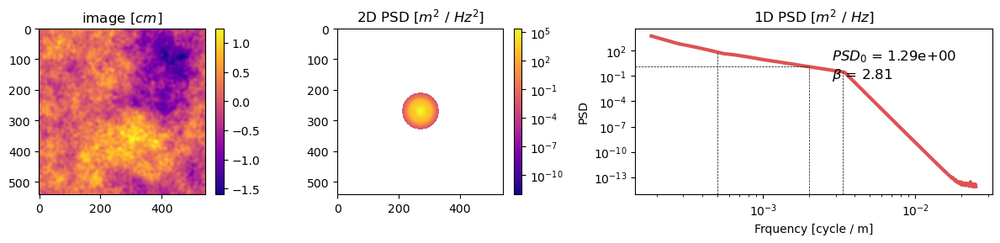

Specified p0 / beta: 1.3 m^2/Hz, 2.8
Simulated p0 / beta: 1.3 m^2/Hz, 2.8
26/28 20170918


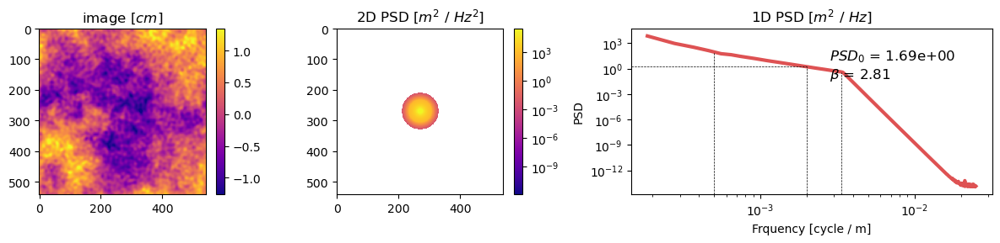

Specified p0 / beta: 1.7 m^2/Hz, 3.3
Simulated p0 / beta: 1.7 m^2/Hz, 2.8
27/28 20170918


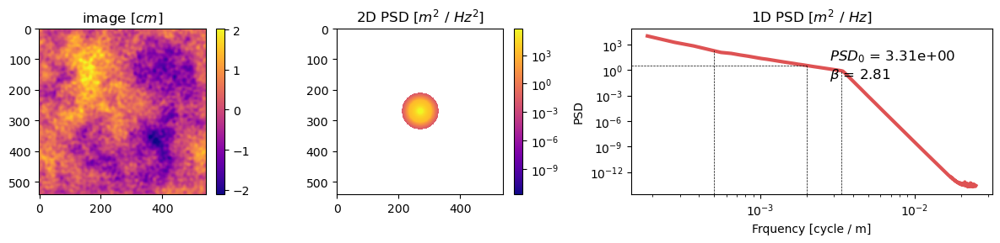

Specified p0 / beta: 3.3 m^2/Hz, 2.8
Simulated p0 / beta: 3.3 m^2/Hz, 2.8
28/28 20170918


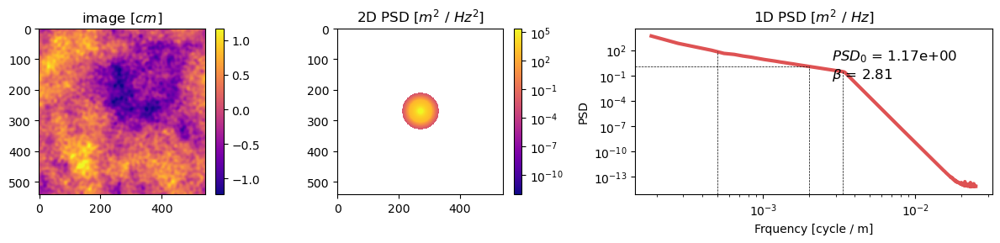

Specified p0 / beta: 1.2 m^2/Hz, 3.1
Simulated p0 / beta: 1.2 m^2/Hz, 2.8


In [5]:
turbu_sim = np.zeros((num_date, ts_obj.length, ts_obj.width), dtype=np.float32)
for i, (p0_i, beta_i) in enumerate(zip(p0, beta)):
    print(f'{i+1}/{num_date} {date_str}')
    # Note 1: given that the slope estimation from above does not look reasonable, I used a fixed slope of 8/3 from Hanssen (2001) instead
    # which gives a more comparable simulation, based on the comparison below with the input reference (timeseriesResidual_ramp.h5)
    # Note 2: we further press the high frequency noise in the simulation by increasing the beta (slope) and its corresponding spatial frequency limit as below
    beta = (8/3 + 0.5, 8/3, 8/3 + 15)
    #low_freq, freq0, high_freq = 1/2e3, 1/5e2, 1/2e2
    kwargs = dict(freq0=freq0, low_freq=low_freq, high_freq=1/3e2)
    turbu_sim[i] = turbu.sim_power_law_image(shape=(ts_obj.length, ts_obj.width), pixel_size=reso, beta=beta, psd0=p0_i, **kwargs)
    p0_sim, beta_sim = turbu.get_power_spectral_density(turbu_sim[i], pixel_size=reso, display=True, **kwargs)[:2]
    print(f'Specified p0 / beta: {p0_i:.1f} m^2/Hz, {beta_i:.1f}')
    print(f'Simulated p0 / beta: {p0_sim:.1f} m^2/Hz, {beta_sim:.1f}')

### Write to HDF5 file

delete exsited file: /Users/yunjunz/Papers/2024-Yang-Tropo/data/mintpy/timeseriesTurbu9.h5
create HDF5 file: /Users/yunjunz/Papers/2024-Yang-Tropo/data/mintpy/timeseriesTurbu9.h5 with w mode
create dataset /timeseries of float32    in size of (28, 541, 541)       with compression=None
create dataset /bperp      of float32    in size of (28,)      with compression=None
create dataset /date       of |S8        in size of (28,)      with compression=None
finished writing to /Users/yunjunz/Papers/2024-Yang-Tropo/data/mintpy/timeseriesTurbu9.h5
view.py /Users/yunjunz/Papers/2024-Yang-Tropo/data/mintpy/timeseriesTurbu9.h5 --wrap --wrap-range -5 5 --noverbose --save


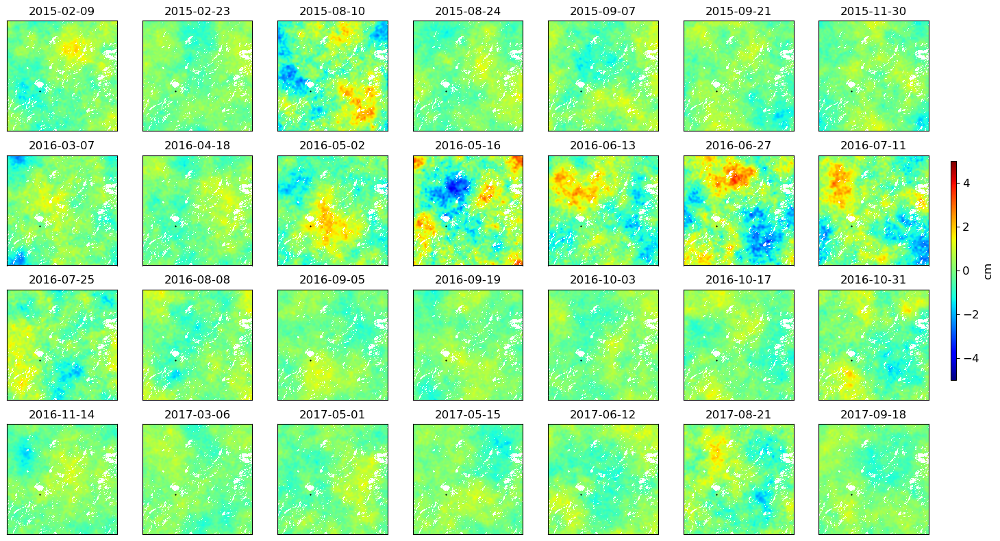

In [6]:
ts_sim_file = os.path.join(data_dir, 'timeseriesTurbu9.h5')
writefile.write(turbu_sim, out_file=ts_sim_file, metadata=ts_obj.metadata, ref_file=ts_res_file)
#view.main(f'{ts_res_file} --wrap --wrap-range -5 5 --save'.split())
view.main(f'{ts_sim_file} --wrap --wrap-range -5 5 --noverbose --save'.split())

### Check the simulation texture

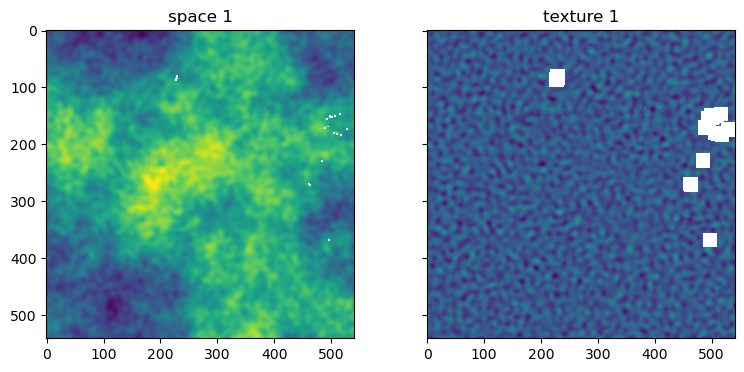

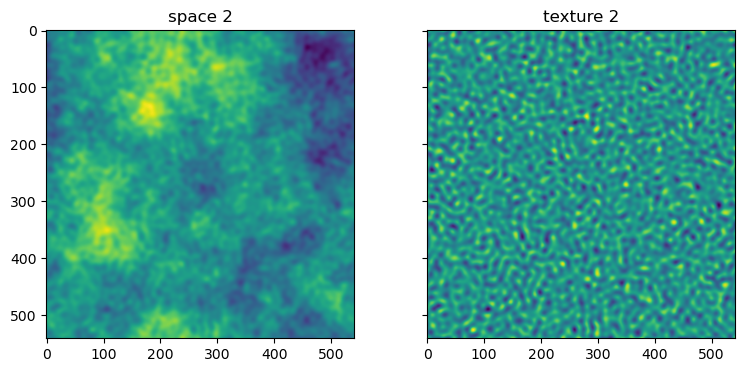

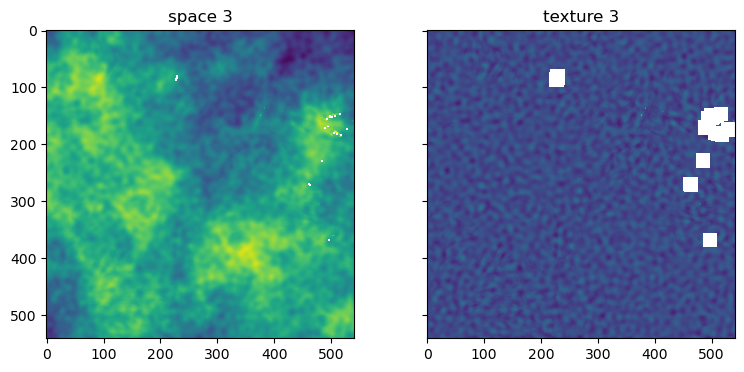

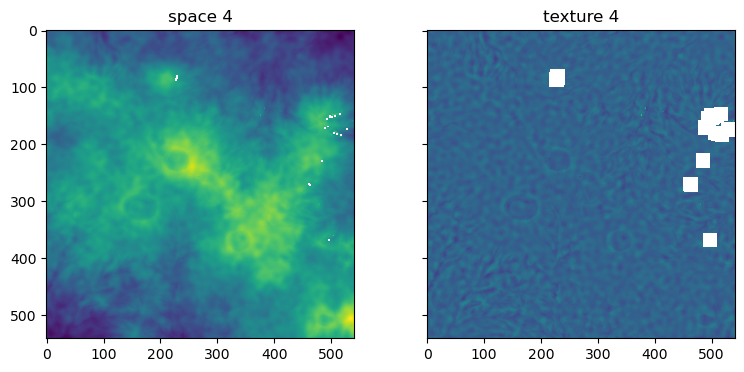

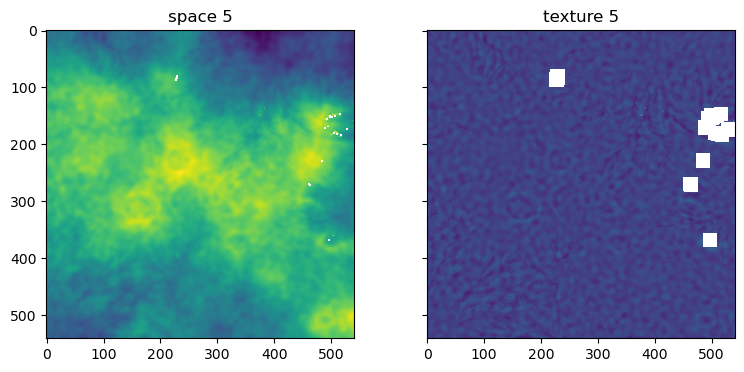

...

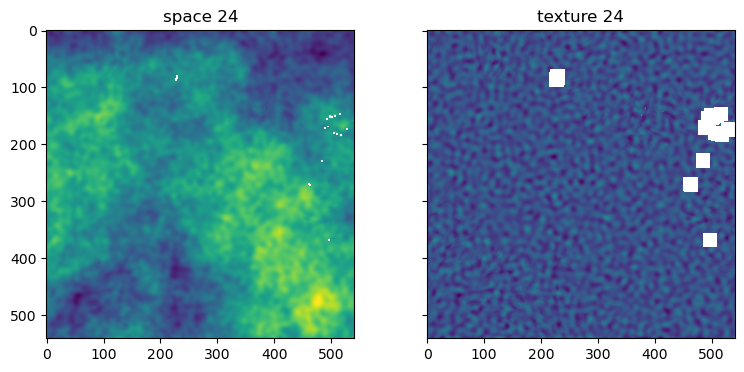

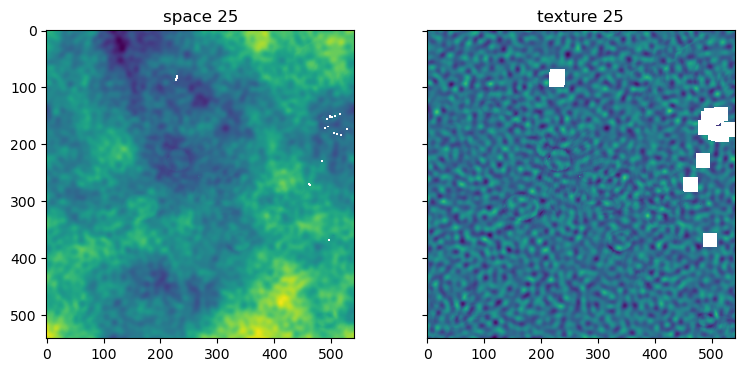

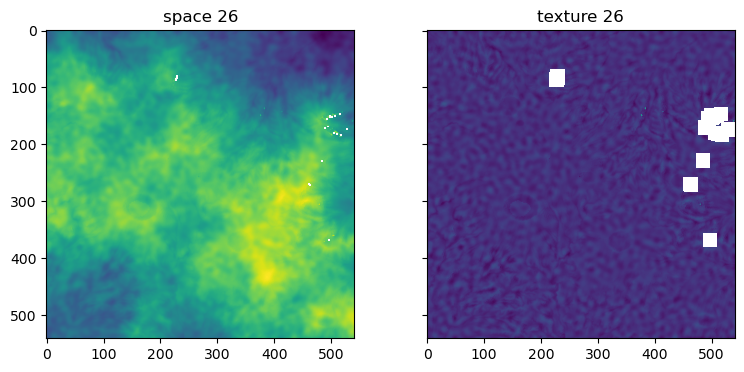

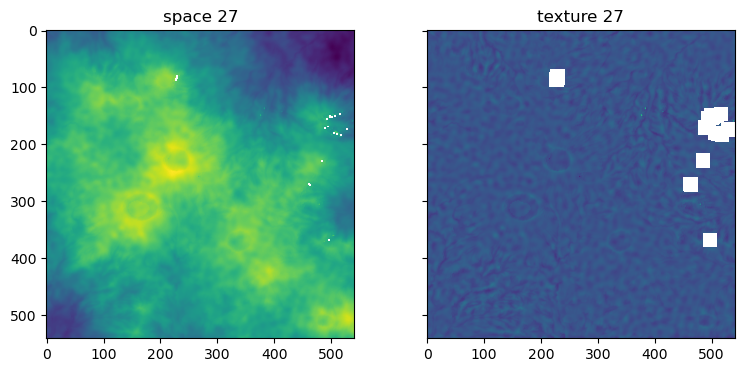

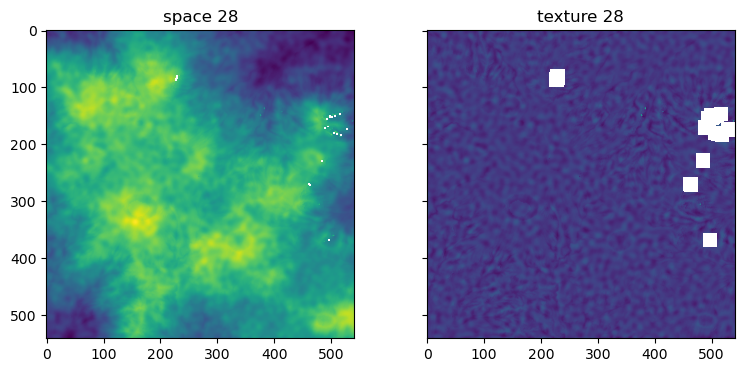

In [9]:
from scipy import ndimage
turbu_file = os.path.join(data_dir, 'timeseriesTurbu0.h5')
strat_file = os.path.join(data_dir, 'ERA5.h5')
turbu_delay = readfile.read(turbu_file)[0]
strat_delay = readfile.read(strat_file)[0]
delay = turbu_delay + strat_delay

# plot
num_date = delay.shape[0]
for i in range(num_date):
    #print(f'{i+1}/{num_date}')
    # apply the high-pass Gaussian filtering
    delay_i_filt = ndimage.gaussian_filter(delay[i], sigma=5, radius=11)
    # plot
    fig, axs = plt.subplots(nrows=1, ncols=2, sharey=True, figsize=[9, 4])
    for ax, data, title in zip(axs, [delay[i], delay[i] - delay_i_filt], [f'space {i+1}', f'texture {i+1}']):
        ax.imshow(data)
        ax.set_title(title)
plt.show()